# Homework 3

**Name:** -- Diana Zepeda Tatengo --

**e-mail:** -- diana.zepeda6085@alumnos.udg.mx --

# MODULES

In [3]:
# Load modules
import numpy as np
import matplotlib.pyplot as plt
import math

from scipy.stats import wrapcauchy
from scipy.stats import levy_stable
from scipy.stats import exponweib
from scipy.spatial import distance

import plotly.graph_objects as go
import pandas as pd

# CLASSES

In [5]:
################# http://www.pygame.org/wiki/2DVectorClass ##################
class Vec2d(object):
    """2d vector class, supports vector and scalar operators,
       and also provides a bunch of high level functions
       """
    __slots__ = ['x', 'y']

    def __init__(self, x_or_pair, y = None):
        if y == None:            
            self.x = x_or_pair[0]
            self.y = x_or_pair[1]
        else:
            self.x = x_or_pair
            self.y = y
            
    # Addition
    def __add__(self, other):
        if isinstance(other, Vec2d):
            return Vec2d(self.x + other.x, self.y + other.y)
        elif hasattr(other, "__getitem__"):
            return Vec2d(self.x + other[0], self.y + other[1])
        else:
            return Vec2d(self.x + other, self.y + other)

    # Subtraction
    def __sub__(self, other):
        if isinstance(other, Vec2d):
            return Vec2d(self.x - other.x, self.y - other.y)
        elif (hasattr(other, "__getitem__")):
            return Vec2d(self.x - other[0], self.y - other[1])
        else:
            return Vec2d(self.x - other, self.y - other)

    # Multiplication
    def __mul__(self, scalar):
        return Vec2d(self.x * scalar, self.y * scalar)
    
    # Vector length
    def get_length(self):
        return math.sqrt(self.x**2 + self.y**2)
    
    # rotate vector
    def rotated(self, angle):        
        cos = math.cos(angle)
        sin = math.sin(angle)
        x = self.x*cos - self.y*sin
        y = self.x*sin + self.y*cos
        return Vec2d(x, y)

# FUNCTIONS

In [7]:
#############################
# Brownian motion trajectoy #
#############################
def bm_2d(n_steps=1000, speed=5, s_pos=[0,0]):
    """
    Arguments:
        n_steps: int, number of steps in the simulation (default is 1000).
        speed: float, magnitude of the step in each iteration (default is 5).
        s_pos: list, initial position [x, y] (default is [0,0]).
    Returns:
        BM_2d_df: returns a DataFrame containing the 2D positions at each step
    """
    # Init velocity vector
    velocity = Vec2d(speed,0)
    
    # Init DF
    BM_2d_df = pd.DataFrame(columns=['x_pos','y_pos'])    
    # Add initial position
    temp_df = pd.DataFrame([{'x_pos':s_pos[0], 'y_pos':s_pos[1]}])    
    BM_2d_df = pd.concat([BM_2d_df, temp_df], ignore_index=True)
    
    # Generate the trajectory
    for i in range(n_steps-1):        
        turn_angle = np.random.uniform(low=-np.pi, high=np.pi)
        velocity = velocity.rotated(turn_angle)
    
        temp_df = pd.DataFrame([{'x_pos':BM_2d_df.x_pos[i]+velocity.x, 'y_pos':BM_2d_df.y_pos[i]+velocity.y}])    
        BM_2d_df = pd.concat([BM_2d_df, temp_df], ignore_index=True)
        
    return BM_2d_df
####################################
# Correlated Random Walk trajectoy #
####################################
def CRW_2d(n_steps=1000, speed=5, s_pos=[0,0], CRW_exponent=0.5):
    """
    Arguments:
        n_steps: int, number of steps in the simulation (default is 1000).
        speed: float, magnitude of the step in each iteration (default is 5).
        s_pos: list, initial position [x, y] (default is [0,0]).
        CRW_exponent: float, alpha value to get the turn_angle from cauchy (default is 0.5)
    Returns:
        CRW_2d: returns a DataFrame containing the 2D positions at each step
    """
    # Init velocity vector
    velocity = Vec2d(speed,0)
    
    # Init DF
    CRW_2d = pd.DataFrame(columns=['x_pos','y_pos'])
    
    # Add initial position
    temp_df = pd.DataFrame([{'x_pos':s_pos[0], 'y_pos':s_pos[1]}])
    
    CRW_2d = pd.concat([CRW_2d, temp_df], ignore_index=True)
    
    # Generate the trajectory
    for i in range(n_steps-1):   
        turn_angle = wrapcauchy.rvs(CRW_exponent) # rvs gets random values from the distribution
        velocity = velocity.rotated(turn_angle)
    
        temp_df = pd.DataFrame([{'x_pos':CRW_2d.x_pos[i]+velocity.x, 'y_pos':CRW_2d.y_pos[i]+velocity.y}])    
        CRW_2d = pd.concat([CRW_2d, temp_df], ignore_index=True)
        
    return CRW_2d

###############
# Path Length #
###############
def path_length(trajectory):
    """
    Calculate the total path length of a given trajectory.
    
    Parameters:
    trajectory: A pandas DataFrame containing the trajectory
    
    Returns:
    path_length: A numpy array containing the cumulative sum of the distances
    """
    # Get the Euclidean Distance
    distances = np.array([distance.euclidean(trajectory.iloc[i-1], trajectory.iloc[i]) for i in range(1, trajectory.shape[0])])
    # Get the Cumulative Sum of the stephs
    return np.cumsum(distances)

#############################
# Mean Squared Displacement #
#############################
def msd(trajectory):
    """
    Compute the Mean Squared Displacement (MSD) for a given trajectory.
    
    Parameters:
    trajectory: A pandas DataFrame containing the trajectory
    
    Returns:
    msd: The MSD as a function of time.
    """
    N = len(trajectory)    
    msd = np.zeros(N-1)
    
    for i in range(1,N):
        displacements = trajectory[i:] - trajectory[:N - i]
        squared_displacements = np.sum(displacements**2, axis=1) # Square each coordinate of the displacement and add them together
        msd[i-1] = np.mean(squared_displacements) # Save the msd
    
    return msd

####################################
#  Get the angles between vectors  #
####################################
def trajectory_angles(trajectory):
    """
    Compute the Turning Angles for a given trajectory.
    
    Parameters:
    trajectory: A pandas DataFrame containing the trajectory
    
    Returns:
    angles: A pandas Series containing the angles
    """
    angles = []

    for i in range(1, len(trajectory) - 1):
        # Get Vectors
        V1 = np.array(trajectory.iloc[i] - trajectory.iloc[i - 1]) # v(i) - v(i-1)
        V2 = np.array(trajectory.iloc[i + 1] - trajectory.iloc[i]) # v(i+1) - v(i)  
        
        # Dot Product
        dot_product = np.dot(V1, V2)
        
        # Vector magnitudes
        norm_V1 = np.linalg.norm(V1)
        norm_V2 = np.linalg.norm(V2)
        
        # Avoid div by 0
        if norm_V1 == 0 or norm_V2 == 0:
            angles.append(0)
            continue
        
        # Calculate the angle     
        cos_theta = dot_product / (norm_V1 * norm_V2)        
                
        theta = np.arccos(cos_theta)  # Cos -1  get angles on [0, 2π]

        # Convert V1 and V2 to 3D (to apply the cross product)
        V1_3D = np.array([V1[0], V1[1], 0], dtype=np.float64)
        V2_3D = np.array([V2[0], V2[1], 0], dtype=np.float64)
        
        # Calculate the cross product in 3D to determine the sign of the angle
        cross_product = np.cross(V1_3D, V2_3D)[-1]
        
        # If cross product is negative, the angle is negative
        if cross_product < 0:
            theta = -theta            
        
        angles.append(theta)  
    
    return pd.Series(angles)

###############
#  Lévy Walk  #
###############
def LevyW_2d(n_steps=1000, speed=5, s_pos=[0,0], alpha=1, beta=1, cauchy=0.7, loc=1):
    """
    Arguments:
        n_steps: int, number of steps in the simulation (default is 1000).
        speed: float, magnitude of the step in each iteration (default is 5).
        s_pos: list, initial position [x, y] (default is [0,0]).
        alpha: float, the stability parameter for the Lévy distribution (default is 1).
        beta: float, the skewness parameter for the Lévy distribution (default is 1).
        cauchy: float, the parameter controlling the dispersion of the Cauchy distribution for the turn angle (default is 0.7).
    Returns:
        Levy_2d: returns a DataFrame containing the 2D positions at each step
    """
    # Init velocity vector
    velocity = Vec2d(speed,0)
    
    # Init DF
    Levy_2d = pd.DataFrame(columns=['x_pos','y_pos'])
    
    # Add initial position
    temp_df = pd.DataFrame([{'x_pos':s_pos[0], 'y_pos':s_pos[1]}])
    
    Levy_2d = pd.concat([Levy_2d, temp_df], ignore_index=True)
    
    # Generate the trajectory
    for i in range(n_steps-1):   
        # Choose a random angle from cauchy distribution
        turn_angle = wrapcauchy.rvs(cauchy)
    
        # Generate step length from lévy distribution
        step_length = levy_stable.rvs(alpha,beta,loc=loc) #loc 1 to get only positive values
    
        velocity = velocity.rotated(turn_angle)
    
        # Calculate the displacement
        displacement = velocity * step_length
    
        temp_df = pd.DataFrame([{'x_pos':Levy_2d.x_pos[i]+displacement.x, 'y_pos':Levy_2d.y_pos[i]+displacement.y}])           
        Levy_2d = pd.concat([Levy_2d, temp_df], ignore_index=True)
        
    return Levy_2d

def step_length(trajectory):
    """
    Calculates the step lengths for a Lévy Flight trajectory.

    Parameters:
    trajectory: pandas DataFrame with 'x_pos' and 'y_pos' columns representing positions.

    Returns:
    step_lengths: A pandas Series representing the length of each step.
    """
    # Calculate the step lengths between consecutive positions using Euclidean distance
    step_lengths = np.array([distance.euclidean(trajectory.iloc[i-1], trajectory.iloc[i]) for i in range(1, trajectory.shape[0])])
    #step_lengths = np.sqrt(np.diff(trajectory['x_pos'])**2 + np.diff(trajectory['y_pos'])**2)
    
    return pd.Series(step_lengths)


# Activities
## 1. Path length - (BM1 vs BM2 vs CRW) 

In [9]:
n_steps = 1000

#Get the Random Walks
BM_2d_df_3 = bm_2d(n_steps, speed=3)
BM_2d_df_6 = bm_2d(n_steps, speed=6)
CRW_2d_df_5 = CRW_2d(n_steps, speed=5)
CRW_2d_df_6 = CRW_2d(n_steps, speed=6)

#Get the Paths Lengths
pl_BM_3 = path_length(BM_2d_df_3)
pl_BM_6 = path_length(BM_2d_df_6)
pl_CRW_5 = path_length(CRW_2d_df_5)
pl_CRW_6 = path_length(CRW_2d_df_6)

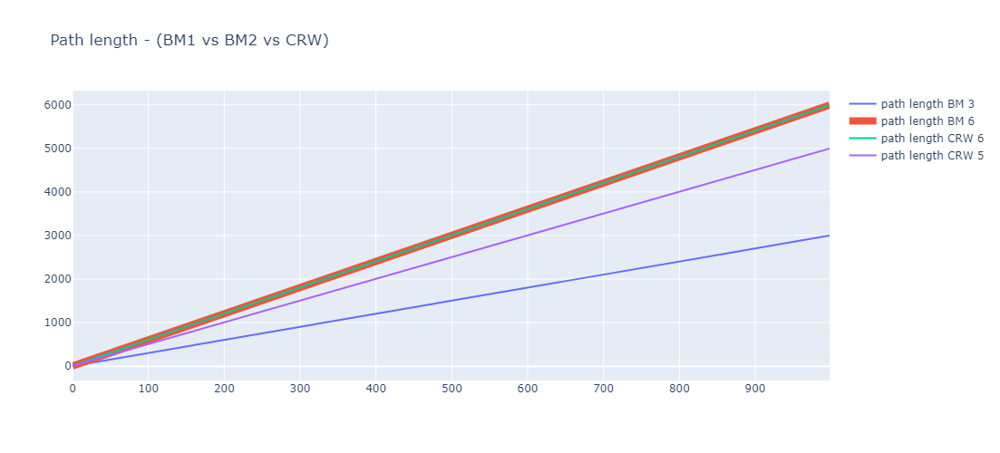

In [10]:
#Plot Results
fig = go.Figure()
fig.add_trace(go.Scatter(x = BM_2d_df_3.index,
                               y = pl_BM_3,                                                    
                               marker = dict(size=2),
                               line = dict(width = 2),
                               mode = 'lines',
                               name = 'path length BM 3',
                               showlegend = True))
fig.add_trace(go.Scatter(x = BM_2d_df_6.index,
                               y = pl_BM_6,                                                    
                               marker = dict(size=2),
                               line = dict(width = 8),
                               mode = 'lines',
                               name = 'path length BM 6',
                               showlegend = True))
fig.add_trace(go.Scatter(x = CRW_2d_df_6.index,
                               y = pl_CRW_6,                                                    
                               marker = dict(size=2),
                               line = dict(width = 2),
                               mode = 'lines',
                               name = 'path length CRW 6',
                               showlegend = True))
fig.add_trace(go.Scatter(x = CRW_2d_df_5.index,
                               y = pl_CRW_5,                                                    
                               marker = dict(size=2),
                               line = dict(width = 2),
                               mode = 'lines',
                               name = 'path length CRW 5',
                               showlegend = True))
fig.update_layout(title_text = 'Path length - (BM1 vs BM2 vs CRW)',
                        autosize = False,
                         width=900, 
                         height=500
)
fig.show()

## 2. Mean Squared Displacement - (BM vs CRW)

The Mean Squared Displacement (MSD) measures how far a particle moves on average after a time $ n $. It is obtained by averaging the squared displacements over all possible positions in the trajectory. 
It is given by:

$$
MSD(n) = \frac{1}{N - n} \sum_{i=1}^{N-n} (\vec{r}_{i+n} - \vec{r}_i)^2
$$

Donde:
- $ N $ is the total number of points in the trajectory.
- $ n $ is the lag time or time interval between two positions.
- $ \vec{r}_i $ the position of the particle in time $ i $.
- $ (\vec{r}_{i+n} - \vec{r}_i)^2 $ represents the quadratic distance between two positions separated by $ n $ steps.

The Mean Squared Displacement (MSD) is a statistical quantity, meaning that we are not only interested in the displacement of a single particle at a single instant but rather in the average of these displacements over time (or across multiple particles if more than one is present).

### 2.1  MSD of The Given Trajectories

Calculation of the MSD and plotting the reference trajectories provided by Dr. Fernando to compare them with my generated trajectories.

In [15]:
# Get the Trajectories from the csvs
ref_BM_2d_df_3 = pd.read_csv('trajectories/brownian_3.csv')
ref_BM_2d_df_6 = pd.read_csv('trajectories/brownian_6.csv')
ref_CRW_2d_df_6_6 = pd.read_csv('trajectories/crw_6_6.csv')
ref_CRW_2d_df_6_9 = pd.read_csv('trajectories/crw_6_9.csv')

# Get the trajectory values
trajectory1 = ref_BM_2d_df_3[['x_pos', 'y_pos']].values
trajectory2 = ref_BM_2d_df_6[['x_pos', 'y_pos']].values
trajectory3 = ref_CRW_2d_df_6_6[['x_pos', 'y_pos']].values
trajectory4 = ref_CRW_2d_df_6_9[['x_pos', 'y_pos']].values

# Calcutate the MSD of the trajectories
msd_BM_3_ref = msd(trajectory1)
msd_BM_6_ref = msd(trajectory2)
msd_CRW_6_6_ref = msd(trajectory3)
msd_CRW_6_9_ref = msd(trajectory4)

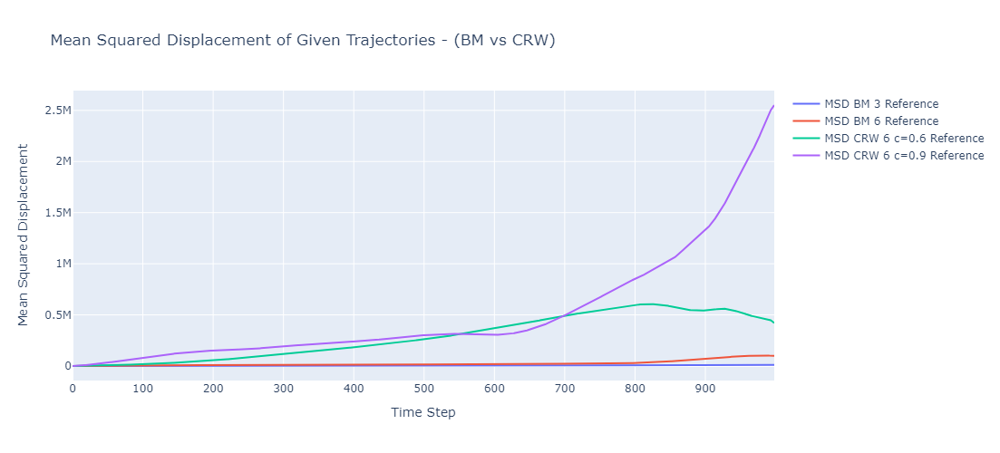

In [137]:
# Plot the results
fig = go.Figure()
fig.add_trace(go.Scatter(
    x = ref_BM_2d_df_3.index,
    y = msd_BM_3_ref,                                                    
    marker = dict(size=2),
    line = dict(width = 2),
    mode = 'lines',
    name = 'MSD BM 3 Reference',
    showlegend = True
))
fig.add_trace(go.Scatter(
    x = ref_BM_2d_df_3.index,
    y = msd_BM_6_ref,                                                    
    marker = dict(size=2),
    line = dict(width = 2),
    mode = 'lines',
    name = 'MSD BM 6 Reference',
    showlegend = True
))
fig.add_trace(go.Scatter(
    x = ref_CRW_2d_df_6_6.index,
    y = msd_CRW_6_6_ref,                                                    
    marker = dict(size=2),
    line = dict(width = 2),
    mode = 'lines',
    name = 'MSD CRW 6 c=0.6 Reference',
    showlegend = True
))
fig.add_trace(go.Scatter(
    x = ref_CRW_2d_df_6_9.index,
    y = msd_CRW_6_9_ref,                                                    
    marker = dict(size=2),
    line = dict(width = 2),
    mode = 'lines',
    name = 'MSD CRW 6 c=0.9 Reference',
    showlegend = True
))

fig.update_layout(
    title_text = 'Mean Squared Displacement of Given Trajectories - (BM vs CRW)',
    autosize = False,
    width=900, 
    height=500,
    xaxis=dict(title="Time Step"),  # Set X-axis label
    yaxis=dict(title="Mean Squared Displacement"),  # Set Y-axis label
)
fig.show()

### 2.2 MSD of the Generated Trajectories

Calculation of the MSD and plotting of my generated trajectories.

In [19]:
n_steps = 1000
s_pos = [0,0]
# Generate Trajectories
BM_2d_df_3 = bm_2d(n_steps, speed=3, s_pos=s_pos)
BM_2d_df_6 = bm_2d(n_steps, speed=6, s_pos=s_pos)
CRW_2d_df_6_6 = CRW_2d(n_steps, speed=6, s_pos=s_pos, CRW_exponent=0.6)
CRW_2d_df_6_9 = CRW_2d(n_steps, speed=6, s_pos=s_pos, CRW_exponent=0.9)

# Get the trajectory values
trajectory7 = BM_2d_df_3[['x_pos', 'y_pos']].values
trajectory8 = BM_2d_df_6[['x_pos', 'y_pos']].values
trajectory9 = CRW_2d_df_6_6[['x_pos', 'y_pos']].values
trajectory10 = CRW_2d_df_6_9[['x_pos', 'y_pos']].values

# Calcutate the MSD of the trajectories
msd_BM_3 = msd(trajectory7)
msd_BM_6 = msd(trajectory8)
msd_CRW_6_6 = msd(trajectory9)
msd_CRW_6_9 = msd(trajectory10)

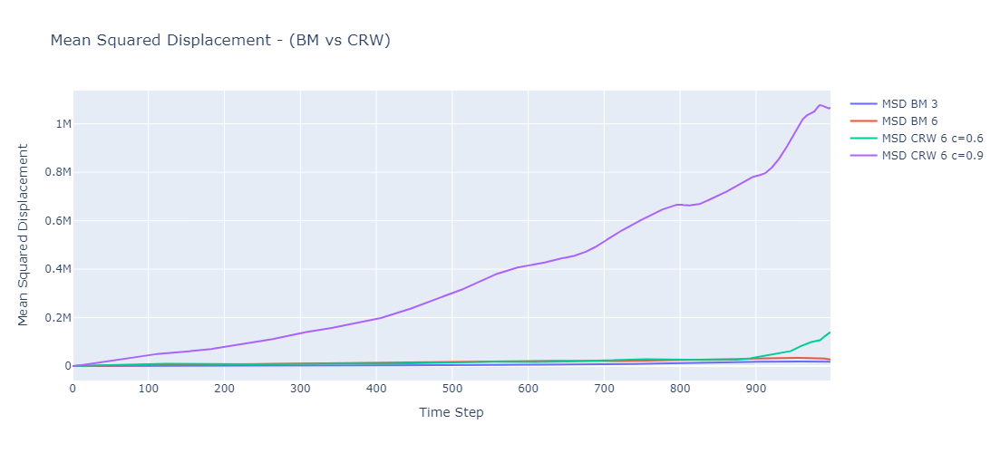

In [131]:
# Plot the results
fig = go.Figure()

fig.add_trace(go.Scatter(x = BM_2d_df_3.index,
                               y = msd_BM_3,                                                    
                               marker = dict(size=2),
                               line = dict(width = 2),
                               mode = 'lines',
                               name = 'MSD BM 3',
                               showlegend = True))
fig.add_trace(go.Scatter(x = BM_2d_df_3.index,
                               y = msd_BM_6,                                                    
                               marker = dict(size=2),
                               line = dict(width = 2),
                               mode = 'lines',
                               name = 'MSD BM 6',
                               showlegend = True))
fig.add_trace(go.Scatter(x = CRW_2d_df_6_6.index,
                               y = msd_CRW_6_6,                                                    
                               marker = dict(size=2),
                               line = dict(width = 2),
                               mode = 'lines',
                               name = 'MSD CRW 6 c=0.6',
                               showlegend = True))
fig.add_trace(go.Scatter(x = CRW_2d_df_6_9.index,
                               y = msd_CRW_6_9,                                                    
                               marker = dict(size=2),
                               line = dict(width = 2),
                               mode = 'lines',
                               name = 'MSD CRW 6 c=0.9',
                               showlegend = True))

fig.update_layout(
    title_text = 'Mean Squared Displacement - (BM vs CRW)',
    autosize = False,
    width=900, 
    height=500,
    xaxis=dict(title="Time Step"),  # Set X-axis label
    yaxis=dict(title="Mean Squared Displacement"),  # Set Y-axis label
)
fig.show()

## 3. Turning-angle Distribution - (source dist. vs observed dist.)

To calculate the **Turning Angle distribution**, we need to understand some concepts. 

**Calculate vectors**

The first one is how to calculate vectors from positions in a trajectory. To obtain the vector, it is done in the following way
$$
V = P_i - P_{i-1} = (x_i - x_{i-1}, y_i - y_{i-1})
$$
where
- **$ P_i $** represents the position at step $ i $, and **$ P_{i-1} $** represents the position at the previous step $ i-1 $.
- **$ (x_i, y_i) $** represents the coordinates of the position $ P_i $, and **$ (x_{i-1}, y_{i-1}) $** represents the coordinates of the previous position $ P_{i-1} $.

**Calculate the angle of vectors**

To calculate the angle between two vectors in the plane (2D), we use the dot product and the cosine angle formula. The angle between the two vectors can be calculated using the following formula:
$$
\theta = \cos^{-1} \left( \frac{\mathbf{V_1} \cdot \mathbf{V_2}}{\|\mathbf{V_1}\| \|\mathbf{V_2}\|} \right)
$$
Where:

1. $ \mathbf{V_1} = $ is the vector 1 $ (x_1, y_1) $
2. $ \mathbf{V_2} = $ is the vector 2 $ (x_2, y_2) $ 
3. $ \mathbf{V_1} \cdot \mathbf{V_2} = $ is the dot product ($ x_1 x_2 + y_1 y_2 $)
4. $ \|\mathbf{V_1}\| = $ is the norm of $ \mathbf{V_1} $ ($\sqrt{x_1^2 + y_1^2}$)
5. $ \|\mathbf{V_2}\| = $ is the norm of $ \mathbf{V_2} $ ($\sqrt{x_2^2 + y_2^2}$)
6. **$ \cos^{-1} $** is the inverse cosine function (arccos), which returns the angle between the two vectors in the range $[0, \pi]$ radians.

Because the formula using **$ \cos^{-1} $** (arccos) only provides angles in the range $[0, \pi]$ radians, it always returns positive values. To extend the range to $[-\pi, \pi]$, we use the sign of the **cross product**.

### 3.1 Turning Angle Distribution of The Given Trajectories

Calculation of the turning angles and plotting of their distribution for the reference trajectories provided by Dr. Fernando to compare them with my generated trajectories.

In [25]:
# Get the Trajectories from the csvs
crw_6_9_ref = pd.read_csv('trajectories/crw_6_9.csv')
crw_6_6_ref = pd.read_csv('trajectories/crw_6_6.csv')

# Calculate the angles
crw_6_9_ref['angle'] = trajectory_angles(crw_6_9_ref).shift(1) 
crw_6_6_ref['angle'] = trajectory_angles(crw_6_6_ref).shift(1)

resolution = 500
aux_domain = np.linspace(-np.pi, np.pi, resolution)

aux_domain_wrapped = np.mod(aux_domain, 2 * np.pi)
aux_domain_wrapped2 = np.mod(aux_domain, 2 * np.pi)

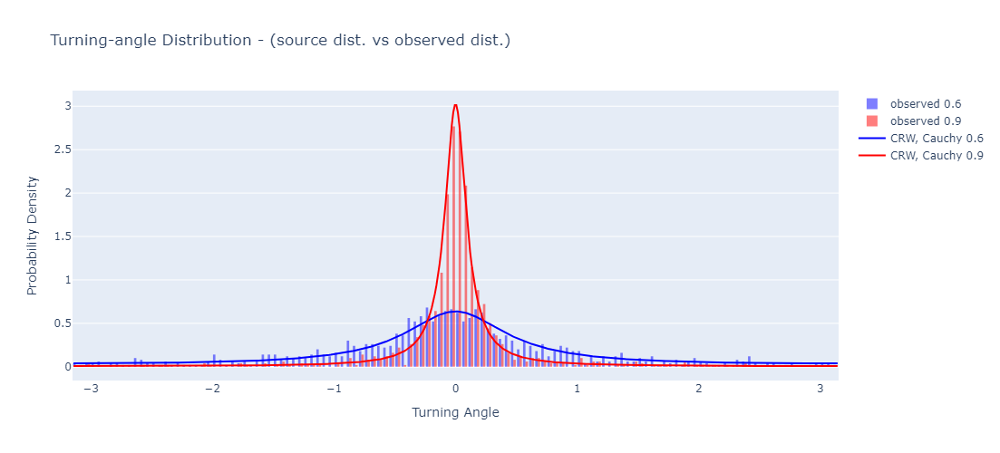

In [127]:
# Plot the results
fig_wrapcauchy_pdf = go.Figure()
wrapcauchy_9_pdf = np.array([wrapcauchy.pdf(i,0.9) for i in aux_domain_wrapped])
wrapcauchy_6_pdf = np.array([wrapcauchy.pdf(i,0.6) for i in aux_domain_wrapped2])

fig_wrapcauchy_pdf.add_trace(go.Histogram(
    x=crw_6_6_ref.angle.values, 
    nbinsx=150, 
    histnorm='probability density', 
    marker=dict(color='blue'),
    opacity=0.5,
    name="observed 0.6"
))
fig_wrapcauchy_pdf.add_trace(go.Histogram(
    x=crw_6_9_ref.angle.values, 
    nbinsx=150, 
    histnorm='probability density',
    marker=dict(color='red'),
    opacity=0.5,
    name="observed 0.9"
))
fig_wrapcauchy_pdf.add_trace(
    go.Scatter(
        x = aux_domain,
        y = wrapcauchy_6_pdf,
        marker = dict(size=2),
        line = dict(width=2, color='blue'),
        mode = 'lines',
        name=f'CRW, Cauchy 0.6',
        showlegend = True
    )
)
fig_wrapcauchy_pdf.add_trace(
    go.Scatter(
        x = aux_domain,
        y = wrapcauchy_9_pdf,
        marker = dict(size=2),
        line = dict(width=2,  color='red'),
        mode = 'lines',            
        name=f'CRW, Cauchy 0.9',
        showlegend = True
    )
)

fig_wrapcauchy_pdf.update_layout(
    title_text = 'Turning-angle Distribution - (source dist. vs observed dist.) ',
    autosize = False,
    width=1000, 
    height=500,
    xaxis=dict(title="Turning Angle"),  # Set X-axis label
    yaxis=dict(title="Probability Density"),  # Set Y-axis label
)

fig_wrapcauchy_pdf.show()

### 3.2 Turning Angle Distribution of The Generated Trajectories

Calculation of the turning angles and plotting of their distribution for the generated trajectories.

In [29]:
# Generate the trajectories
crw_6_9 = CRW_2d(n_steps, speed=6, s_pos=[2,5], CRW_exponent=0.9)
crw_6_6 = CRW_2d(n_steps, speed=6, s_pos=[2,5], CRW_exponent=0.6)
crw_6_3 = CRW_2d(n_steps, speed=6, s_pos=[2,5], CRW_exponent=0.3)

# Calculate the angles
crw_6_9['angle'] = trajectory_angles(crw_6_9).shift(1)  
crw_6_6['angle'] = trajectory_angles(crw_6_6).shift(1)
crw_6_3['angle'] = trajectory_angles(crw_6_3).shift(1)

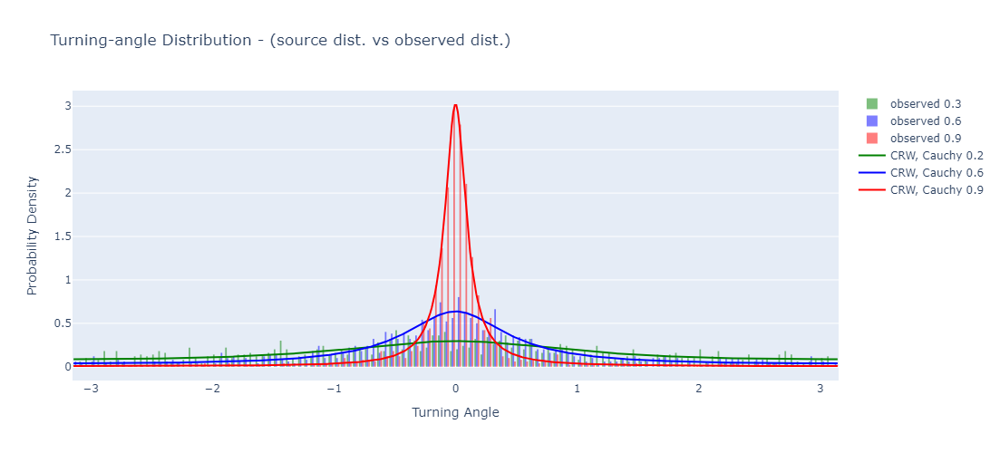

In [125]:
# Plot the results
resolution = 500
aux_domain = np.linspace(-np.pi, np.pi, resolution)

aux = np.mod(aux_domain, 2 * np.pi)
aux2 = np.mod(aux_domain, 2 * np.pi)
aux3 = np.mod(aux_domain, 2 * np.pi)

fig_wrapcauchy_pdf = go.Figure()
wrapcauchy_9_pdf = np.array([wrapcauchy.pdf(i,0.9) for i in aux])
wrapcauchy_6_pdf = np.array([wrapcauchy.pdf(i,0.6) for i in aux2])
wrapcauchy_3_pdf = np.array([wrapcauchy.pdf(i,0.3) for i in aux3])

fig_wrapcauchy_pdf.add_trace(go.Histogram(
    x=crw_6_3.angle.values, 
    nbinsx=150, 
    histnorm='probability density', 
    marker=dict(color='green'),
    opacity=0.5,
    name="observed 0.3"
))
fig_wrapcauchy_pdf.add_trace(go.Histogram(
    x=crw_6_6.angle.values, 
    nbinsx=150, 
    histnorm='probability density', 
    marker=dict(color='blue'),
    opacity=0.5,
    name="observed 0.6"
))
fig_wrapcauchy_pdf.add_trace(go.Histogram(
    x=crw_6_9.angle.values, 
    nbinsx=150, 
    histnorm='probability density',
    marker=dict(color='red'),
    opacity=0.5,
    name="observed 0.9"
))
fig_wrapcauchy_pdf.add_trace(
    go.Scatter(
        x = aux_domain,
        y = wrapcauchy_3_pdf,
        marker = dict(size=2),
        line = dict(width=2, color='green'),
        mode = 'lines',
        name=f'CRW, Cauchy 0.2',
        showlegend = True
    )
)
fig_wrapcauchy_pdf.add_trace(
    go.Scatter(
        x = aux_domain,
        y = wrapcauchy_6_pdf,
        marker = dict(size=2),
        line = dict(width=2, color='blue'),
        mode = 'lines',
        name=f'CRW, Cauchy 0.6',
        showlegend = True
    )
)
fig_wrapcauchy_pdf.add_trace(
    go.Scatter(
        x = aux_domain,
        y = wrapcauchy_9_pdf,
        marker = dict(size=2),
        line = dict(width=2,  color='red'),
        mode = 'lines',            
        name=f'CRW, Cauchy 0.9',
        showlegend = True
    )
)

fig_wrapcauchy_pdf.update_layout(
    title_text = 'Turning-angle Distribution - (source dist. vs observed dist.) ',
    autosize = False,
    width=1000, 
    height=500,
    xaxis=dict(title="Turning Angle"),  # Set X-axis label
    yaxis=dict(title="Probability Density"),  # Set Y-axis label
)

fig_wrapcauchy_pdf.show()

## 4. Step-length Distribution - (source dist. vs observed dist.)

In [113]:
# Initial Parameters
alpha1 = 1
alpha2 = 0.7
m = 4.5 # To set loc 
beta = 1
n_steps = 1000;
resolution = 600
x = np.linspace(0, 50, resolution)

# Generate the Levy Walks
LevyW_1 = LevyW_2d(n_steps, speed=1, alpha=alpha1, cauchy=0.5, loc=m)
LevyW_2 = LevyW_2d(n_steps, speed=1, alpha=alpha2, cauchy=0.5, loc=m)

# Get the steps length
sl_1 = step_length(LevyW_1)
sl_2 = step_length(LevyW_2)

# Filter values to keep only those ≤ 50
sl_1 = sl_1[sl_1 <= 50]
sl_2 = sl_2[sl_2 <= 50]

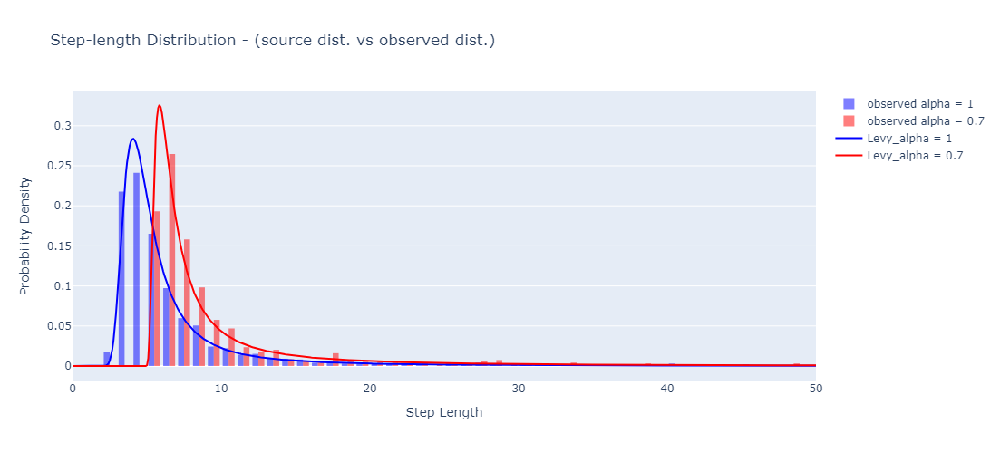

In [121]:
# Plot the results
fig_levy_pdf = go.Figure()

# Adding histograms of observed step lengths
fig_levy_pdf.add_trace(go.Histogram(
    x=sl_1,
    nbinsx=80,  # Adjusted the number of bins for better visualization
    histnorm='probability density',
    marker=dict(color='blue'),
    opacity=0.5,
    name=f'observed alpha = {alpha1}'
))
fig_levy_pdf.add_trace(go.Histogram(
    x=sl_2,
    nbinsx=80,  # Adjusted the number of bins for better visualization
    histnorm='probability density',
    marker=dict(color='red'),
    opacity=0.5,
    name=f'observed alpha = {alpha2}'
))
# Adding all the curves
fig_levy_pdf.add_trace(go.Scatter(
    x=x, 
    y=levy_stable.pdf(x, alpha1, beta, loc=m),
    marker = dict(size=2),
    line = dict(width=2, color='blue'),
    mode='lines', 
    name=f'Levy_alpha = {alpha1}'
))

fig_levy_pdf.add_trace(go.Scatter(
    x=x, 
    y=levy_stable.pdf(x, alpha2, beta, loc=m),
    marker = dict(size=2),
    line = dict(width=2, color='red'),
    mode='lines',    
    name=f'Levy_alpha = {alpha2}'
))

fig_levy_pdf.update_layout(
    title=" Step-length Distribution - (source dist. vs observed dist.) ",
    width=800, 
    height=500,
    xaxis=dict(title="Step Length",range=[0, 50]),  # Set X-axis label and Adjusted range to [0, 50]
    yaxis=dict(title="Probability Density"),  # Set Y-axis label
)

fig_levy_pdf.show()